In [1]:
import wandb
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import pandas as pd
from guided_diffusion.plot_util import palettes
import scipy.stats as st

In [108]:
class WandbRun:
    def __init__(self, run_id):
        self.run_id = run_id
        self.api = wandb.Api()
        self.run = self.api.run(f'sinzlab/egg/{run_id}')

    def history(self):
        return self.run.history()

    def get_image(self, data):
        try:
            filename = data.image['path']
            file = self.run.file(filename)
            filename = file.download(exist_ok=True).name
            image = Image.open(filename)
            image = np.array(image)
        except:
            image = np.zeros((100, 100))

        return image


In [202]:
def imshow(image, ax=None):
    if ax is None:
        ax = plt.gca()

    ax.imshow(image, cmap='gray')
    ax.axis('off')

In [177]:
gt_images = np.load('../scripts/75_monkey_test_imgs.npy')
run = WandbRun('dumwlquk')
run_gd = WandbRun('3nmju72v')
history = run.history()
history_gd = run_gd.history()

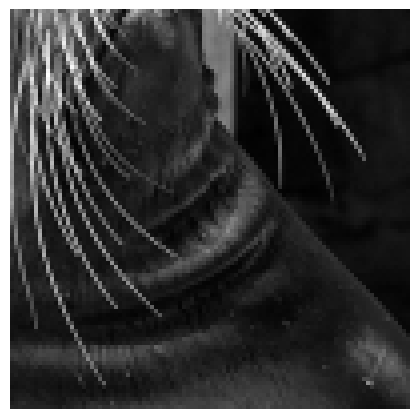

In [208]:
plt.figure(figsize=(4, 4))
imshow(gt_images[14])
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
plt.savefig('gt_recon_6.png', dpi=150, pad_inches=0)

0


wandb: WARNING A graphql request initiated by the public wandb API timed out (timeout=9 sec). Create a new API with an integer timeout larger than 9, e.g., `api = wandb.Api(timeout=19)` to increase the graphql timeout.


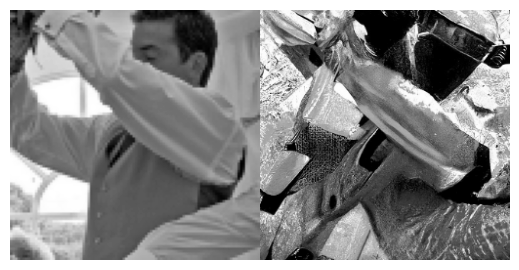

1


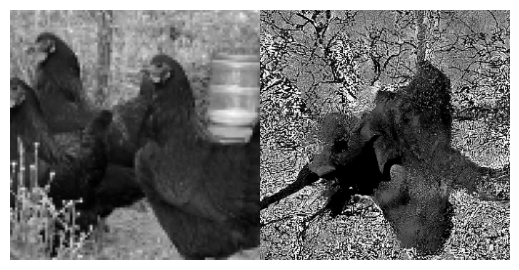

2


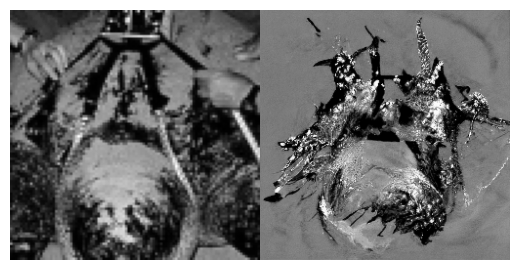

3


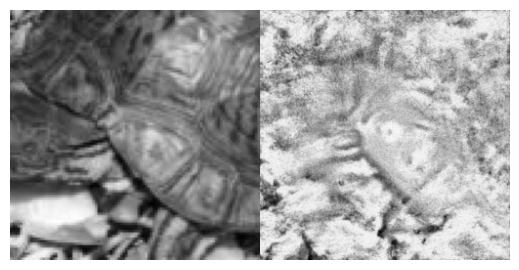

4


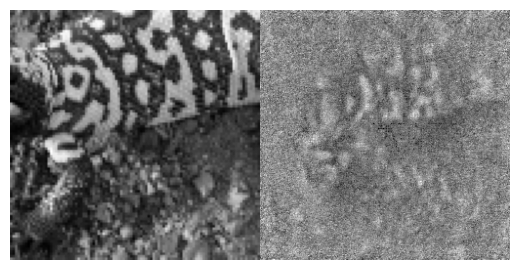

5


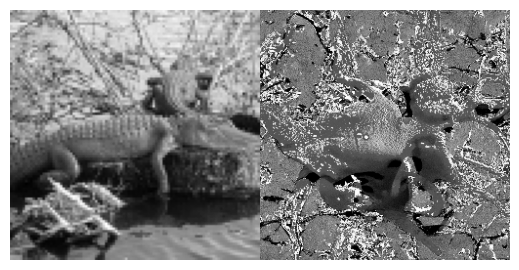

6


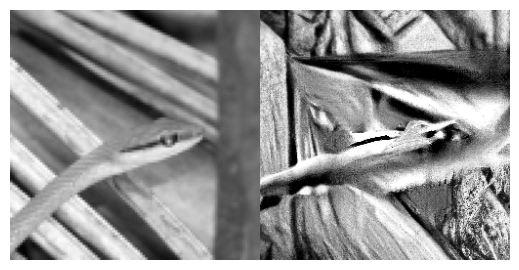

7


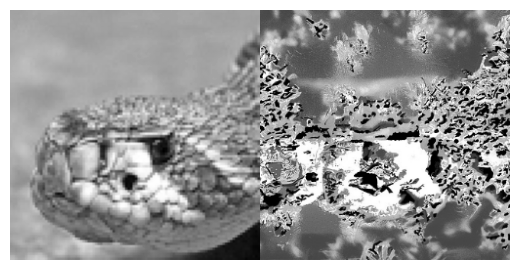

8


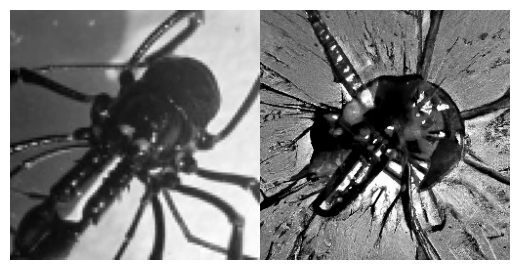

9


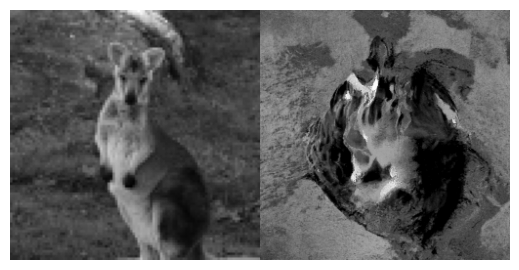

10


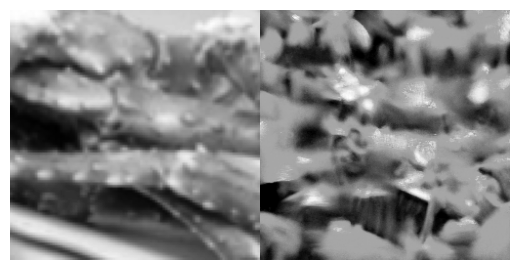

11


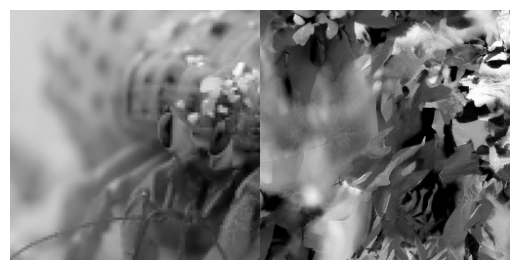

12


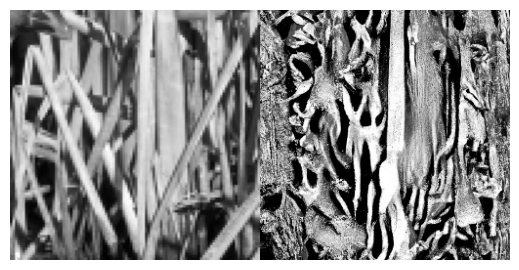

13


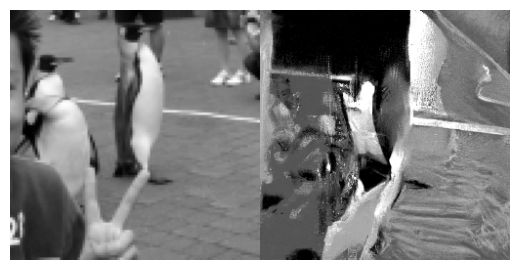

14


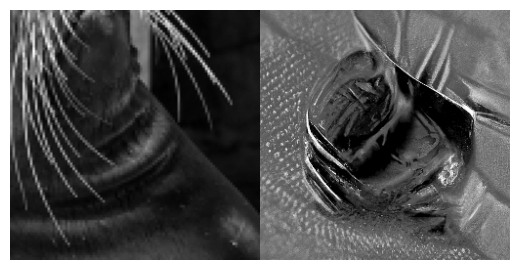

15


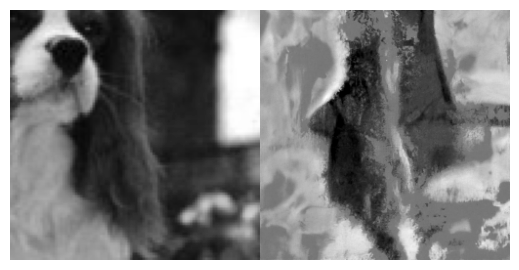

16


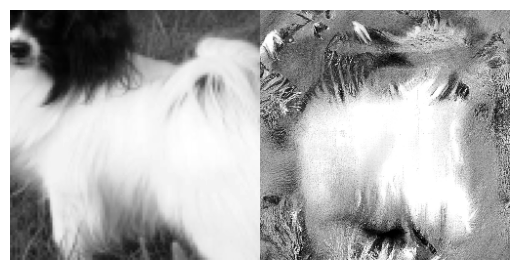

17


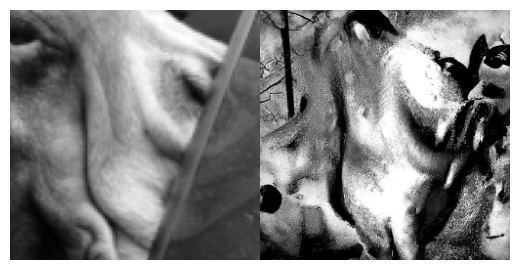

18


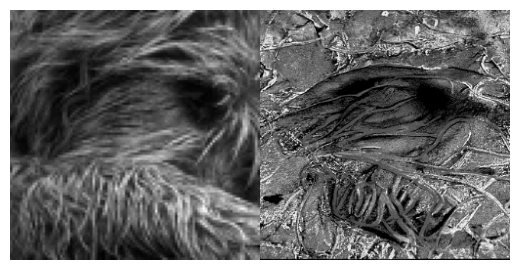

19


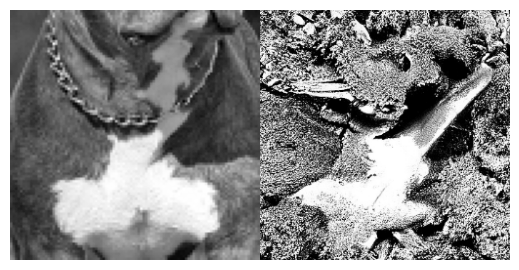

20


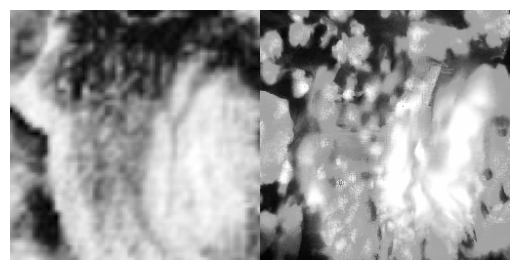

21


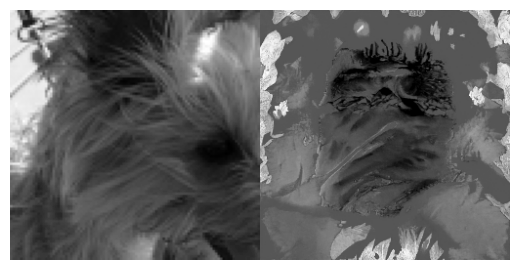

22


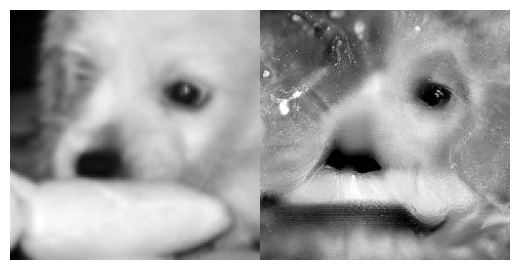

23


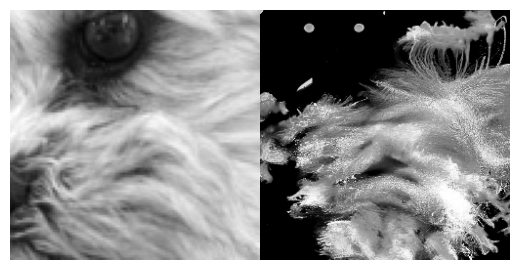

24


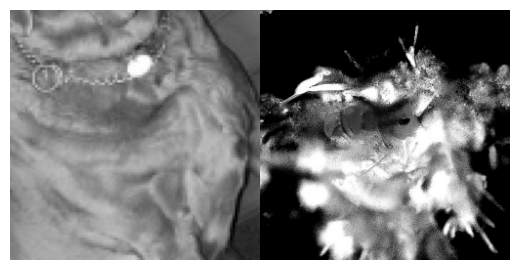

25


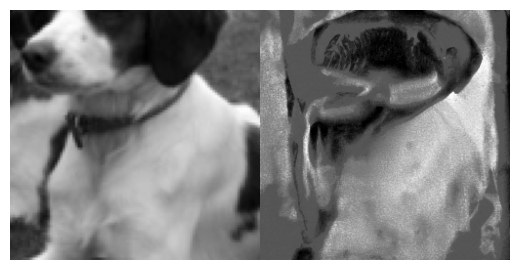

26


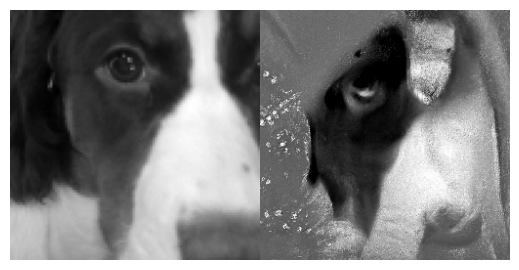

27


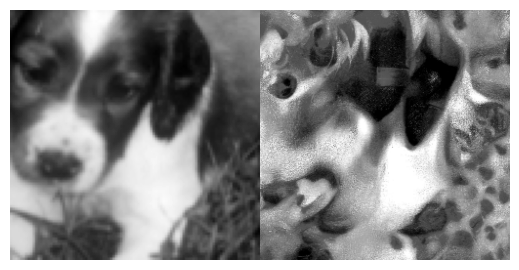

28


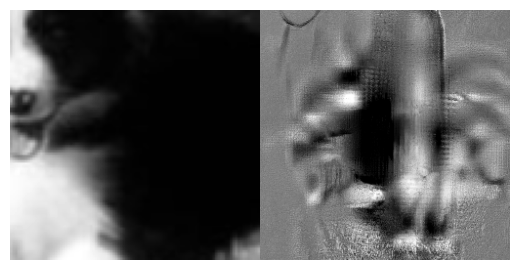

29


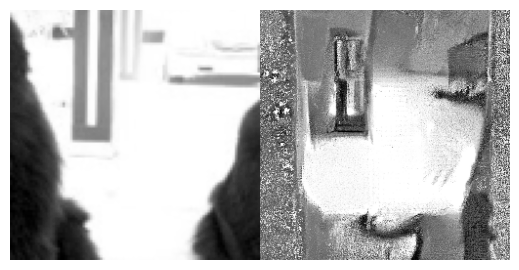

30


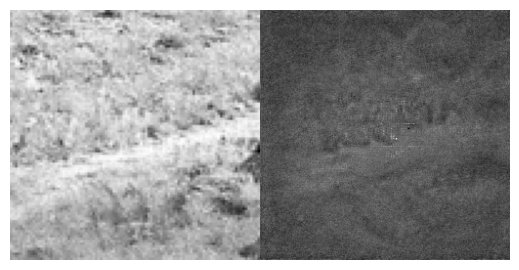

31


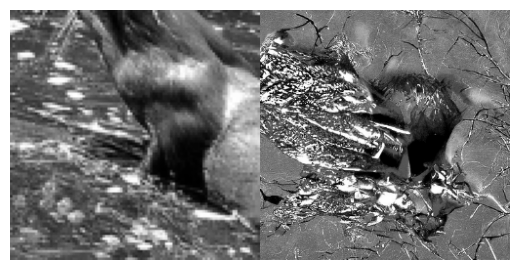

32


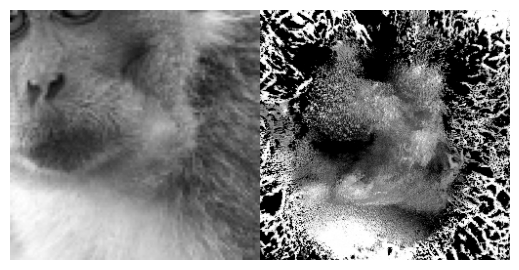

33


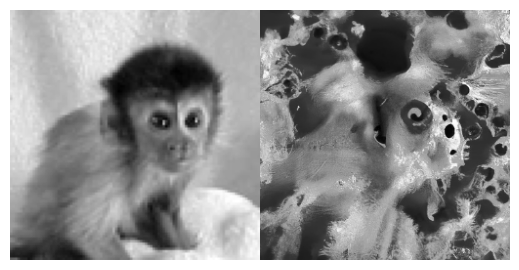

34


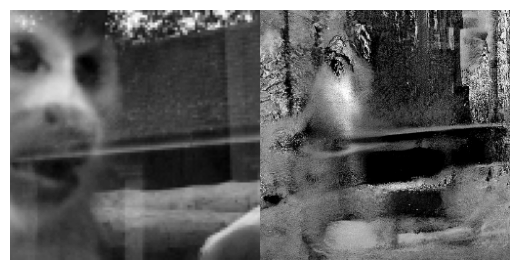

35


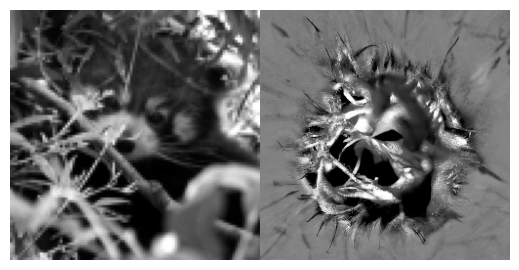

36


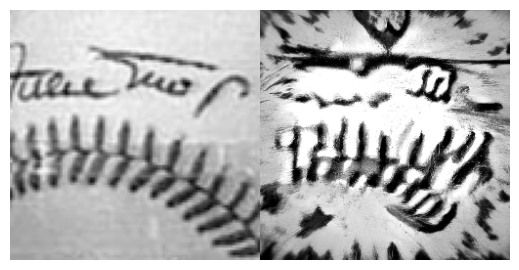

37


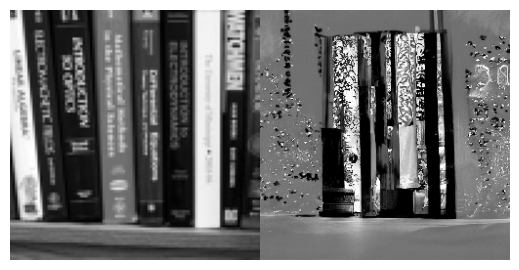

38


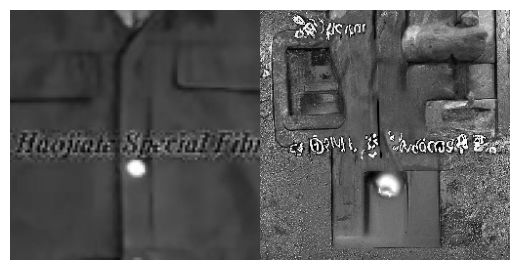

39


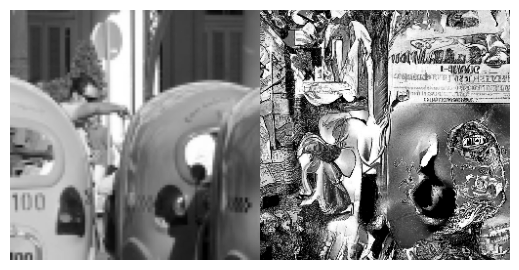

40


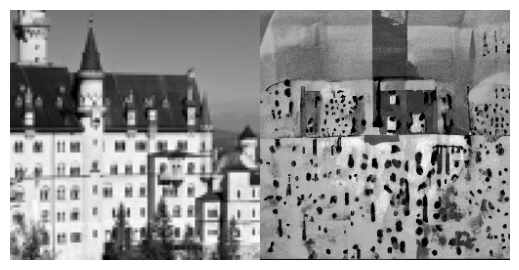

41


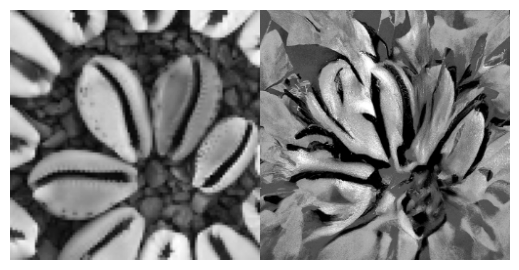

42


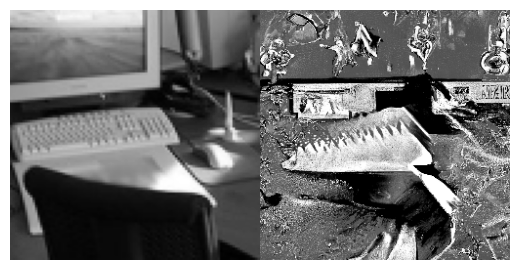

43


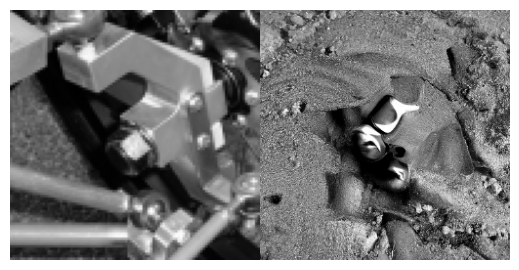

44


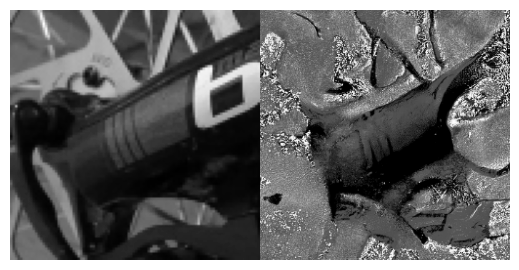

45


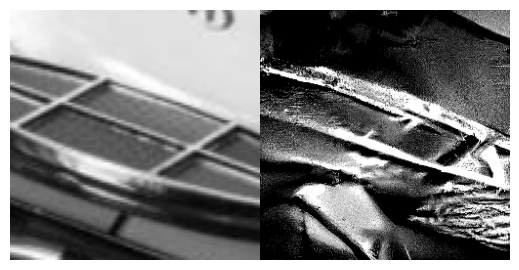

46


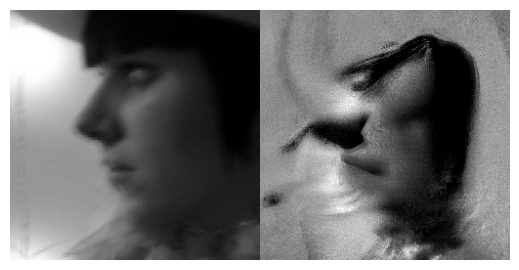

47


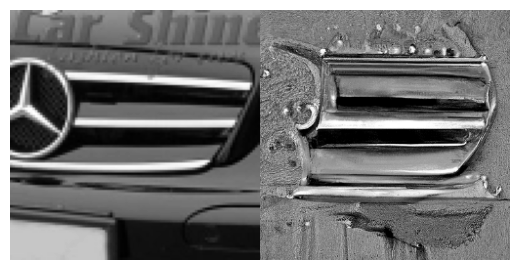

48


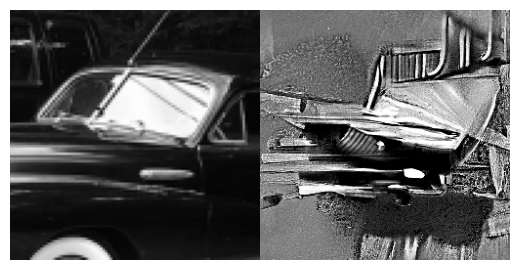

49


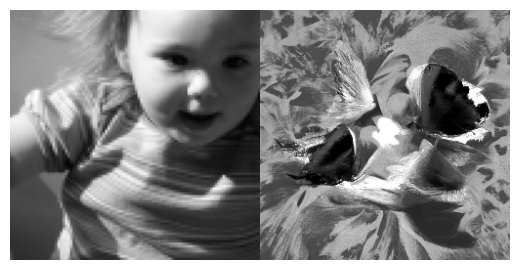

50


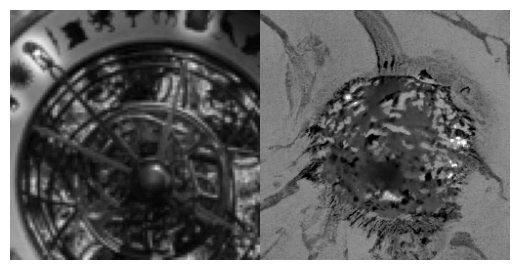

51


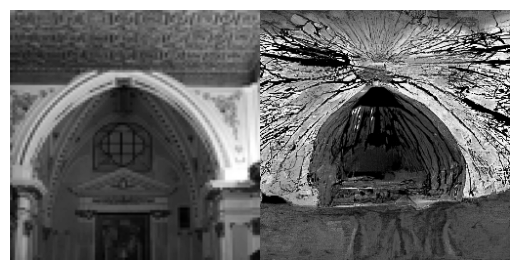

52


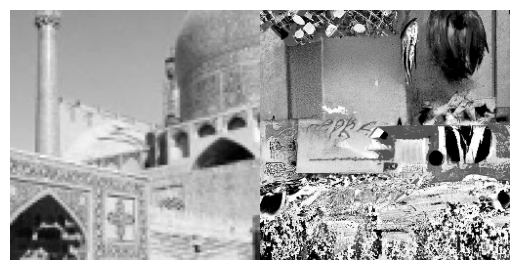

53


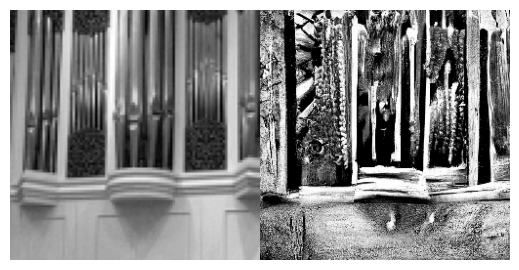

54


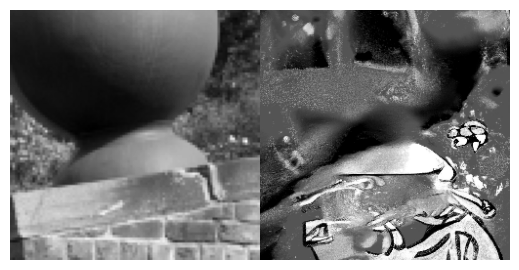

55


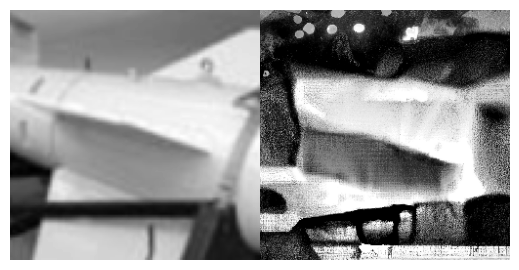

56


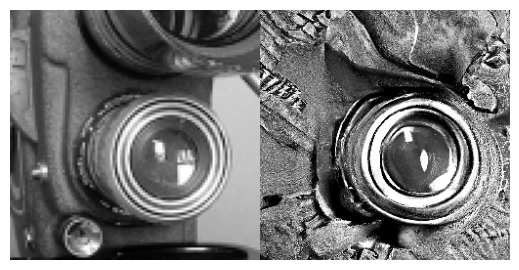

57


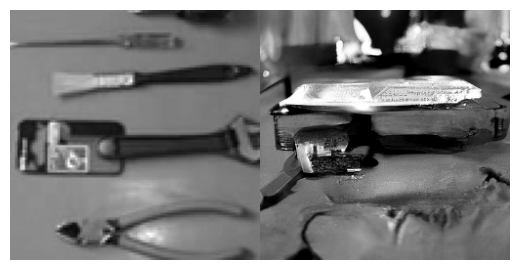

58


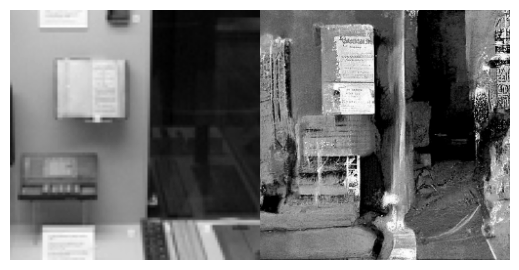

59


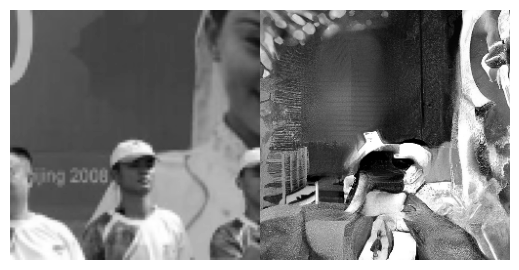

60


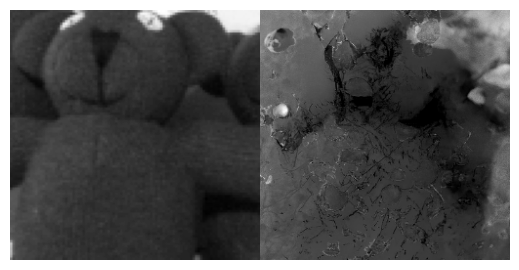

61


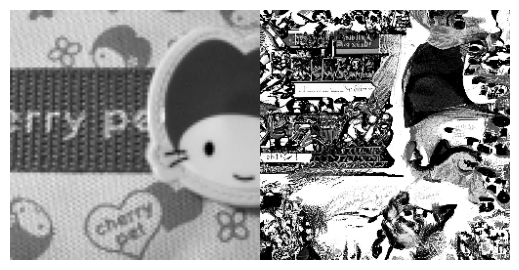

62


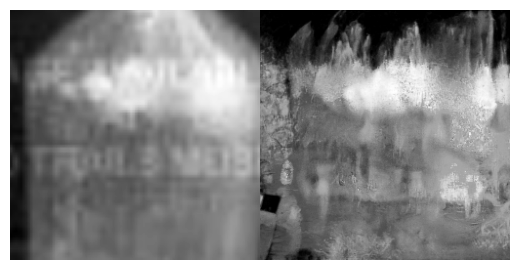

63


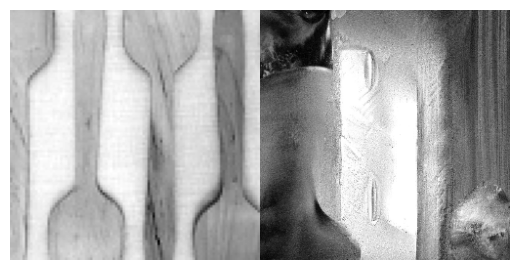

64


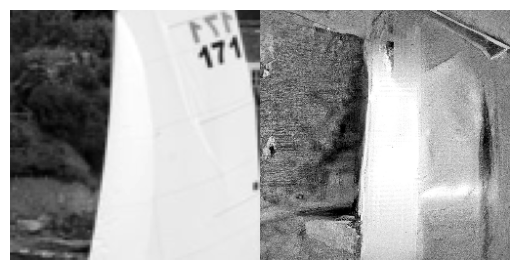

65


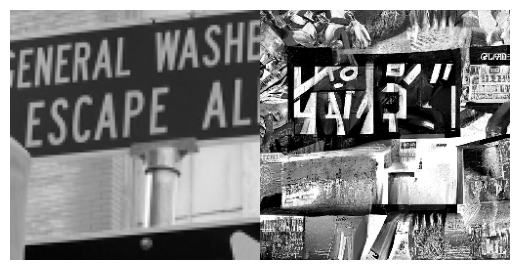

66


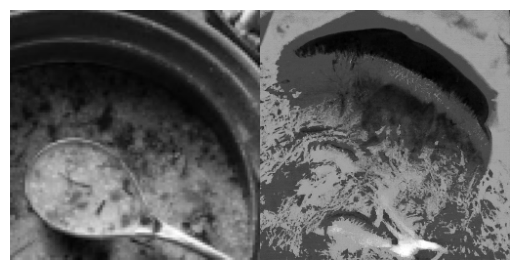

67


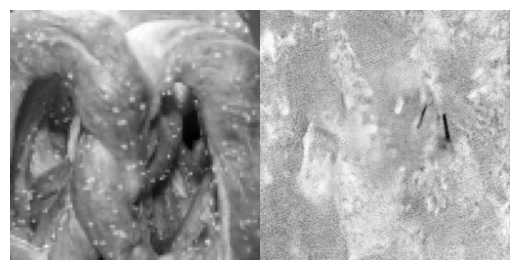

68


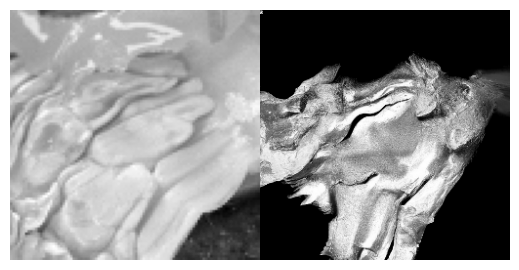

69


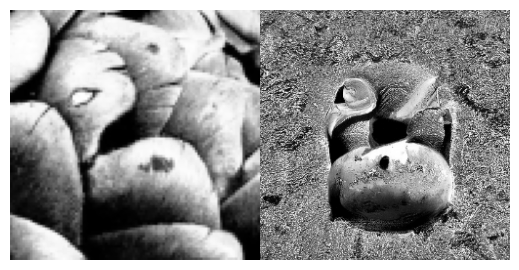

70


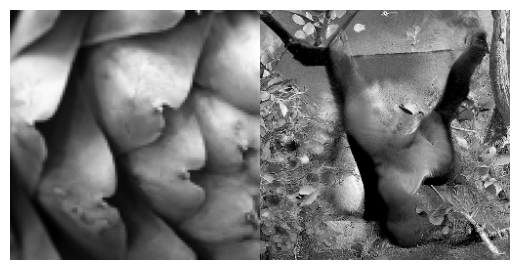

71


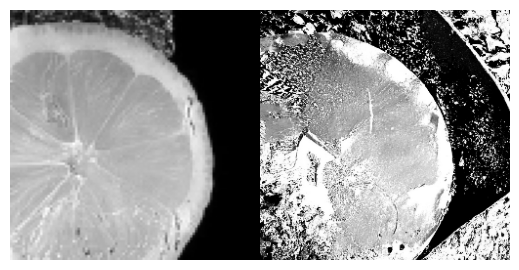

72


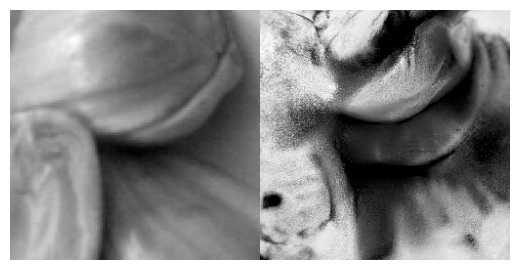

73


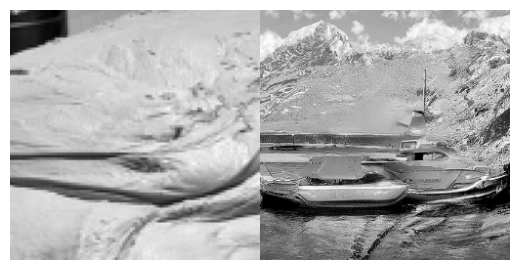

74


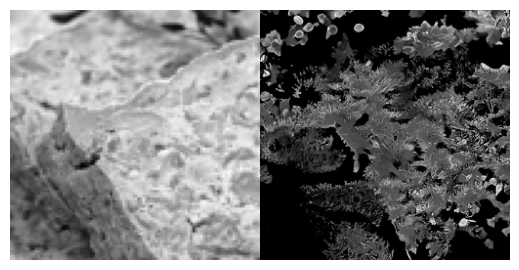

In [200]:
nimages = 75

for i in range(nimages):
    print(i)
    fig, axs = plt.subplots(1, 2, figsize=(2 * 2.5, 2.5))
    plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
    plt.margins(0, 0)
    imshow(gt_images[i], ax=axs[0])
    imshow(run.get_image(history.iloc[i]), ax=axs[1])
    plt.show()

Chosen 12 images


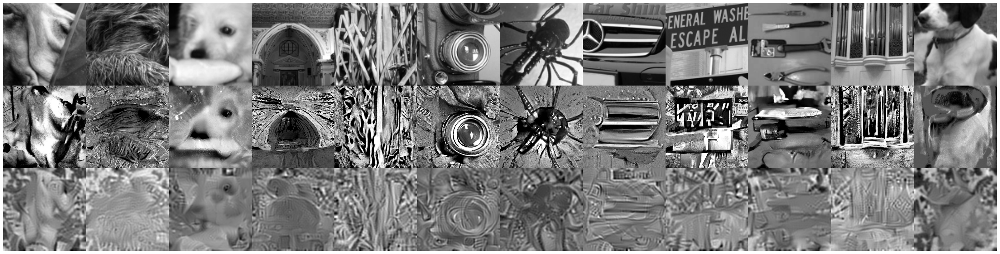

In [178]:
curated = np.array([
    8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65
])

np.random.seed(1)
np.random.shuffle(curated)

nimages = len(curated)
print(f'Chosen {nimages} images')

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])

    try:
        img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    except:
        img_gd = np.zeros((100, 100))
    imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig('./recon.png', dpi=150, bbox_inches='tight', pad_inches=0)

Chosen 4 images


wandb: WARNING A graphql request initiated by the public wandb API timed out (timeout=9 sec). Create a new API with an integer timeout larger than 9, e.g., `api = wandb.Api(timeout=19)` to increase the graphql timeout.


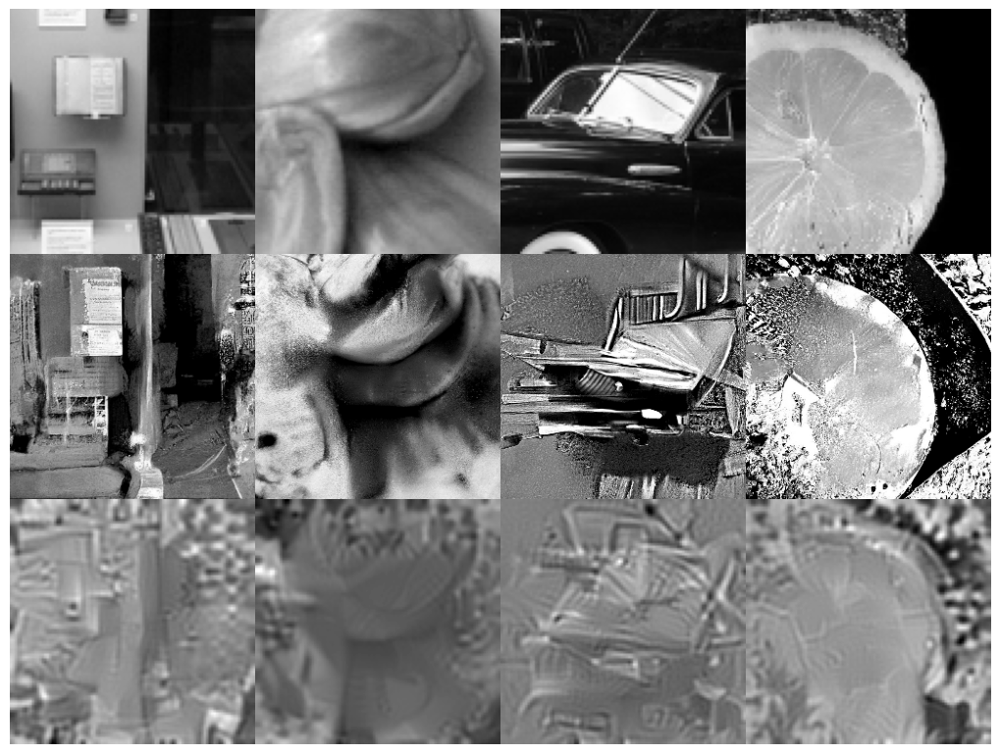

In [201]:
curated = np.array([
    48, 71, 72, 58
])

np.random.seed(1)
np.random.shuffle(curated)

nimages = len(curated)
print(f'Chosen {nimages} images')

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])

    try:
        img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    except:
        img_gd = np.zeros((100, 100))
    imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig('./recon_examples.png', dpi=150, bbox_inches='tight', pad_inches=0)

In [221]:
units = np.arange(75)
units = np.delete(units, [41, 48, 71, 72, 58, 8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65])

np.random.seed(1)
us = np.random.choice(units, 25, replace=False)
us = np.delete(us, 4)

curated = us[:12]

nimages = len(curated)
print(f'Chosen {nimages} images')

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])

    try:
        img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    except:
        img_gd = np.zeros((100, 100))
    imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig('./recon_supplementary.png', dpi=150, bbox_inches='tight', pad_inches=0)

Chosen 12 images


Chosen 12 images


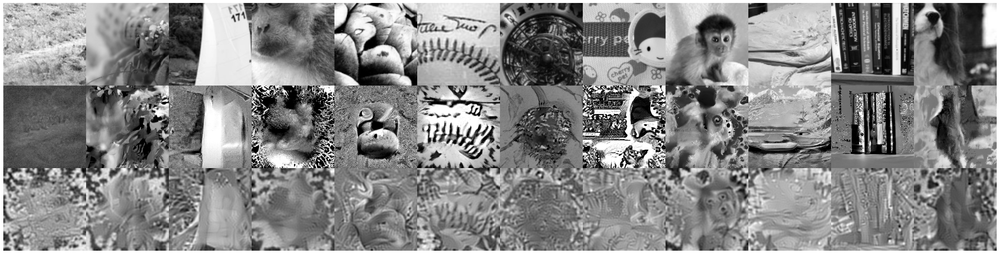

In [223]:
units = np.arange(75)
units = np.delete(units, [41, 48, 71, 72, 58, 8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65])

np.random.seed(1)
us = np.random.choice(units, 27, replace=False)
us = np.delete(us, 4)
us = np.delete(us, [12, 22])

curated = us[12:]

nimages = len(curated)
print(f'Chosen {nimages} images')

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])

    try:
        img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    except:
        img_gd = np.zeros((100, 100))
    imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig('./recon_supplementary_2.png', dpi=150, bbox_inches='tight', pad_inches=0)

Chosen 12 images


wandb: WARNING A graphql request initiated by the public wandb API timed out (timeout=9 sec). Create a new API with an integer timeout larger than 9, e.g., `api = wandb.Api(timeout=19)` to increase the graphql timeout.
wandb: WARNING A graphql request initiated by the public wandb API timed out (timeout=9 sec). Create a new API with an integer timeout larger than 9, e.g., `api = wandb.Api(timeout=19)` to increase the graphql timeout.


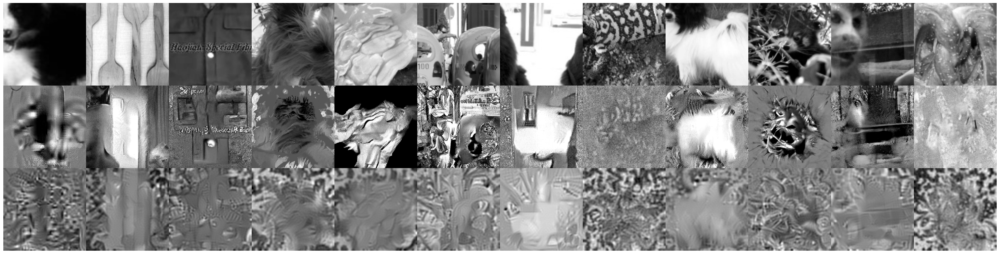

In [224]:
units = np.arange(75)
units = np.delete(units, [41, 48, 71, 72, 58, 8, 12, 17, 18, 22, 25, 56, 47, 53, 57, 51, 65])

np.random.seed(1)
us = np.random.choice(units, 39, replace=False)
us = np.delete(us, 4)
us = np.delete(us, [12, 22])

curated = us[24:]

nimages = len(curated)
print(f'Chosen {nimages} images')

fig, axs = plt.subplots(3, nimages, figsize=(nimages * 2.5, 3 * 2.5))
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.margins(0, 0)
for pos_idx, image_idx in enumerate(curated):
    imshow(gt_images[image_idx], ax=axs[0, pos_idx])
    imshow(run.get_image(history.iloc[image_idx]), ax=axs[1, pos_idx])

    try:
        img_gd = run_gd.get_image(history_gd.iloc[image_idx])
    except:
        img_gd = np.zeros((100, 100))
    imshow(img_gd, ax=axs[2, pos_idx])

plt.savefig('./recon_supplementary_3.png', dpi=150, bbox_inches='tight', pad_inches=0)

In [ ]:
np.save('./target_l2.npy', history['train'].to_numpy())

In [119]:
df = history.merge(history_gd, on='unit_idx', suffixes=['_d', '_m'])

In [124]:
print(df['train_m'].mean(), df['train_d'].mean())
print(df['val_m'].mean(), df['val_d'].mean())
print(df['cross-val_m'].mean(), df['cross-val_d'].mean())

0.005861769068620301 0.005844662764242717
0.0071249169081316465 0.00651150535434551
0.5187983571418694 0.1531367632560432


In [127]:
import scipy.stats as st

print(st.wilcoxon(df['val_d'], df['val_m']))
print(st.wilcoxon(df['cross-val_d'], df['cross-val_m']))

WilcoxonResult(statistic=186.0, pvalue=5.971528245007682e-07)
WilcoxonResult(statistic=3.0, pvalue=8.880118337733133e-11)


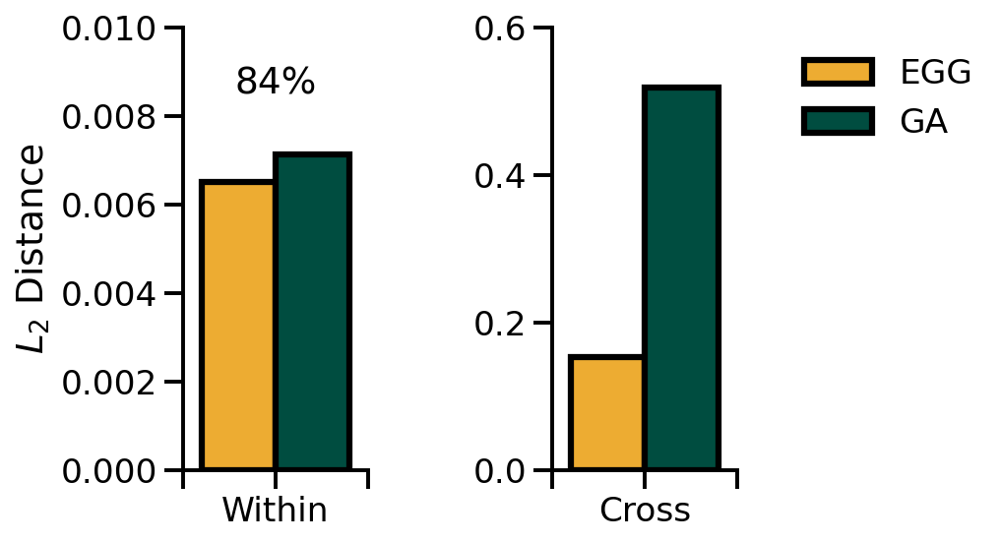

In [199]:
import seaborn as sns
sns.set_context('talk')
plt.figure(figsize=(5, 3), dpi=150, facecolor='w')
plt.subplots_adjust(top=1, bottom=0, right=1, left=0, hspace=0, wspace=0)
plt.subplot(1, 2, 1)
plt.bar([0 - 0.2], [df['val_d'].mean()], color=[palettes['candy']['yellow'], palettes['candy']['yellow']], edgecolor='k', linewidth=3, width=0.4, label='EGG')
plt.bar([0 + 0.2], [df['val_m'].mean()], color=[palettes['candy']['green'], palettes['candy']['green']], edgecolor='k', linewidth=3, width=0.4, label='GA')

plt.xlim(-0.5, 1.5)
plt.ylim(0, 0.01)

plt.xticks([-0.5, 0, 0.5], ['', 'Within', ''])
plt.yticks([0, 0.002, 0.004, 0.006, 0.008, 0.010])

plt.ylabel('$L_2$ Distance')
plt.subplot(1, 2, 2)
plt.bar([0 - 0.2], [df['cross-val_d'].mean()], color=[palettes['candy']['yellow'], palettes['candy']['yellow']], edgecolor='k', linewidth=3, width=0.4, label='EGG')
plt.bar([0 + 0.2], [df['cross-val_m'].mean()], color=[palettes['candy']['green'], palettes['candy']['green']], edgecolor='k', linewidth=3, width=0.4, label='GA')

plt.xlim(-0.5, 1.5)

plt.xticks([-0.5, 0, 0.5], ['', 'Cross', ''])
plt.yticks([0, 0.2, 0.4, 0.6])
plt.ylim(0, .6)

sns.despine(trim=True)
plt.legend(frameon=False, bbox_to_anchor=(0.6, 1))
plt.tight_layout()
plt.savefig('reconstruction_error.png', dpi=150, bbox_inches='tight', pad_inches=0)

In [192]:
print(sum(df['val_d'] < df['val_m']) / len(df['val_d']))
print(sum(df['cross-val_d'] < df['cross-val_m']) / len(df['val_d']))

0.8392857142857143
0.9821428571428571
